In [1]:
import fastf1
import fastf1.plotting
import pandas as pd 
import numpy as np
import re
from matplotlib import pyplot as plt
print(fastf1.__version__)
from fastf1 import utils
from fastf1.core import Laps
import fastf1.plotting
import matplotlib.pyplot as plt


fastf1.plotting.setup_mpl(misc_mpl_mods=False)

3.0.7


In [18]:
#QUALY
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")
year=2023
wknd="Abu Dhabi"
ses="Q"
session = fastf1.get_session(year, wknd, ses)
session.load()
driver="LEC"
lap=session.laps.pick_driver(driver).pick_fastest()
print (lap)

#Telemetry
x = lap.telemetry['X']              
y = lap.telemetry['Y']
speed = lap.telemetry['Speed']
tel=pd.DataFrame({'X': x, 'Y': y,'Speed': speed })

#tel.to_csv('PIAQABU.csv')

core           INFO 	Loading data for Abu Dhabi Grand Prix - Qualifying [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '81', '63', '4', '22', '14', '27', '11', '10', '44', '31', '18', '23', '3', '55', '20', '77', '24', '2']


Time                      0 days 01:14:51.382000
Driver                                       LEC
DriverNumber                                  16
LapTime                   0 days 00:01:23.584000
LapNumber                                   17.0
Stint                                        6.0
PitOutTime                                   NaT
PitInTime                                    NaT
Sector1Time               0 days 00:00:17.213000
Sector2Time               0 days 00:00:35.986000
Sector3Time               0 days 00:00:30.385000
Sector1SessionTime        0 days 01:13:45.011000
Sector2SessionTime        0 days 01:14:20.997000
Sector3SessionTime        0 days 01:14:51.382000
SpeedI1                                    290.0
SpeedI2                                    322.0
SpeedFL                                    220.0
SpeedST                                    326.0
IsPersonalBest                              True
Compound                                    SOFT
TyreLife            

In [12]:
#Gap Qualy
import fastf1
import pandas as pd

# Enable cache
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")

# Initialize DataFrame
gapQ = pd.DataFrame(columns=['Driver', 'Gap'])

year = 2023
gp = "Mexico"
ses = 'Q'

# Get session data
session = fastf1.get_session(year, gp, ses)
session.load()
drivers = pd.unique(session.laps['Driver'])
list_fastest_laps = []

# Calculate fastest laps for each driver
for drv in drivers:
    drvs_fastest_lap = session.laps.pick_driver(drv).pick_fastest()
    list_fastest_laps.append(drvs_fastest_lap)

fastest_laps = fastf1.core.Laps(list_fastest_laps).sort_values(by='LapTime').reset_index(drop=True)
pole_lap = fastest_laps.iloc[0]  # Get the pole position lap

# Calculate and store gap in seconds
for index, row in fastest_laps.iterrows():
    gap = (row['LapTime'] - pole_lap['LapTime']).total_seconds()  # Calculate gap in seconds
    pos = {'Driver': row['Driver'], 'Gap': gap}
    gapQ = gapQ.append(pos, ignore_index=True)

# Print and save results
print(gapQ)
#gapQ.to_csv("GapAustin.csv", index=False)

core           INFO 	Loading data for Mexico City Grand Prix - Qualifying [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['16', '55', '1', '3', '11', '44', '81', '63', '77', '24', '10', '27', '14', '23', '22', '31', '20', '18', '4', '2']


   Driver    Gap
0     LEC    0.0
1     SAI  0.067
2     VER  0.097
3     RIC  0.216
4     PER  0.257
5     HAM  0.288
6     PIA  0.457
7     RUS  0.507
8     BOT   0.85
9     ZHO  0.884
10    GAS  1.355
11    HUL  1.358
12    ALO  1.572
13    ALB  1.662
14    TSU  1.724
15    OCO  1.914
16    MAG  1.997
17    STR  2.061
18    NOR  4.388
19    NaT    NaT


/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/15540665.py:33: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gapQ = gapQ.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/15540665.py:33: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gapQ = gapQ.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/15540665.py:33: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gapQ = gapQ.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/15540665.py:33: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gapQ = 

In [17]:
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")
year=2023
wknd="Abu Dhabi"
ses="Q"
session = fastf1.get_session(year, wknd, ses)
session.load()
driver="VER"
laps = session.laps.pick_driver(driver)
fl=session.laps.pick_driver(driver).pick_fastest()
laps=laps.dropna(subset=['Sector1Time'])
laps=laps.dropna(subset=['Sector2Time'])
laps=laps.dropna(subset=['Sector3Time'])
FS1 = min(laps['Sector1Time']).total_seconds()
FS2 = min(laps['Sector2Time']).total_seconds()
FS3 = min(laps['Sector3Time']).total_seconds()
ILap = FS1 + FS2 + FS3
print(fl)

core           INFO 	Loading data for Abu Dhabi Grand Prix - Qualifying [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '81', '63', '4', '22', '14', '27', '11', '10', '44', '31', '18', '23', '3', '55', '20', '77', '24', '2']


Time                      0 days 01:06:17.158000
Driver                                       VER
DriverNumber                                   1
LapTime                   0 days 00:01:23.445000
LapNumber                                   11.0
Stint                                        4.0
PitOutTime                                   NaT
PitInTime                                    NaT
Sector1Time               0 days 00:00:17.151000
Sector2Time               0 days 00:00:35.894000
Sector3Time               0 days 00:00:30.400000
Sector1SessionTime        0 days 01:05:10.864000
Sector2SessionTime        0 days 01:05:46.758000
Sector3SessionTime        0 days 01:06:17.158000
SpeedI1                                    291.0
SpeedI2                                    324.0
SpeedFL                                    222.0
SpeedST                                    328.0
IsPersonalBest                              True
Compound                                    SOFT
TyreLife            

In [6]:
#Ideal lap
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")
year=2023
wknd="Abu Dhabi"
ses="Q"
session = fastf1.get_session(year, wknd, ses)
session.load()
drivers = pd.unique(session.laps['Driver'])
ideallaps = pd.DataFrame(columns=['Driver', 'Lap'])
for driver in drivers:
    laps = session.laps.pick_driver(driver)
    laps=laps.dropna(subset=['Sector1Time'])
    laps=laps.dropna(subset=['Sector2Time'])
    laps=laps.dropna(subset=['Sector3Time'])
    FS1 = min(laps['Sector1Time']).total_seconds()
    FS2 = min(laps['Sector2Time']).total_seconds()
    FS3 = min(laps['Sector3Time']).total_seconds()
    ILap = FS1 + FS2 + FS3
    lap = {'Driver': driver, 'Lap': ILap}
    ideallaps = ideallaps.append(lap,ignore_index=True)

print("IDEAL LAPS")
print(ideallaps)
fastestlap=min(ideallaps['Lap'])
idealgap = pd.DataFrame(columns=['Driver', 'Gap'])

for driver in drivers:
    gap = ideallaps[ideallaps['Driver'] == driver]['Lap'].iloc[0] - fastestlap
    gapQI = {'Driver': driver, 'Gap': gap}
    idealgap = idealgap.append(gapQI, ignore_index=True)

print("\nGap Fastest Lap:")
print(idealgap)
idealgap.to_csv("idealgapABU.csv", index=False)

adf = pd.DataFrame(columns=['Driver', 'FastestLap'])
for driver in drivers:
    lap = session.laps.pick_driver(driver).pick_fastest()
    lt = lap["LapTime"]
    lt_seconds = lt.total_seconds()
    adf = adf.append({'Driver': driver, 'FastestLap': lt_seconds}, ignore_index=True)
print(adf)
gtl = pd.DataFrame(columns=['Driver', 'Gap'])
for driver in drivers:
    gap = adf[adf['Driver'] == driver]['FastestLap'].iloc[0] - ideallaps[ideallaps['Driver'] == driver]['Lap'].iloc[0]
    gtl = gtl.append({'Driver': driver, 'Gap': gap}, ignore_index=True)

# Print or save the 'gtl' DataFrame
print(gtl)

core           INFO 	Loading data for Abu Dhabi Grand Prix - Qualifying [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '81', '63', '4', '22', '14', '27', '11', '10', '44', '31', '18', '23', '3', '55', '20', '77', '24', '2']
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a fut

/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  idealgap = idealgap.append(gapQI, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  idealgap = idealgap.append(gapQI, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  idealgap = idealgap.append(gapQI, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas

IDEAL LAPS
   Driver     Lap
0     VER  83.372
1     LEC  83.559
2     PIA  83.691
3     RUS  83.668
4     NOR  83.575
5     TSU  83.922
6     ALO  84.013
7     HUL  84.017
8     PER  83.868
9     GAS  84.078
10    HAM   84.05
11    OCO   84.38
12    STR  84.268
13    ALB  84.189
14    RIC  84.394
15    SAI  84.641
16    MAG  84.743
17    BOT  84.788
18    ZHO  84.745
19    SAR  84.532

Gap Fastest Lap:
   Driver    Gap
0     VER    0.0
1     LEC  0.187
2     PIA  0.319
3     RUS  0.296
4     NOR  0.203
5     TSU   0.55
6     ALO  0.641
7     HUL  0.645
8     PER  0.496
9     GAS  0.706
10    HAM  0.678
11    OCO  1.008
12    STR  0.896
13    ALB  0.817
14    RIC  1.022
15    SAI  1.269
16    MAG  1.371
17    BOT  1.416
18    ZHO  1.373
19    SAR   1.16


/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  adf = adf.append({'Driver': driver, 'FastestLap': lt_seconds}, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  adf = adf.append({'Driver': driver, 'FastestLap': lt_seconds}, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:41: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  adf = adf.append({'Driver': driver, 'FastestLap': lt_seconds}, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_7496/62605766.py:41: FutureWarning: The frame.appe

AttributeError: 'float' object has no attribute 'total_seconds'

In [8]:
#LapTimes
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")
year = 2023
wknd = "Las Vegas"
ses = "R"
session = fastf1.get_session(year, wknd, ses)
session.load()
#drivers = ["VER","NOR","HAM"]
driversc=pd.unique(session.laps['Driver'])
lap_data2 = []
for driver in driversc:
    driver_laps = session.laps.pick_driver(driver).pick_quicklaps().reset_index()
    #driver_laps = driver_laps[driver_laps['LapNumber'] >= 40]  # Filter for laps up to 22
    driver_laps['Driver'] = driver  # Add driver column
    driver_laps['LapTime'] = driver_laps['LapTime'].dt.total_seconds()  # Convert to seconds
    lap_data2.append(driver_laps)

# Concatenate the lap data for all drivers
all_laps2 = pd.concat(lap_data2, ignore_index=True)

# Save the lap data to a CSV file
csv_filename = "laptimesRVegas.csv"
all_laps2.to_csv(csv_filename, index=False)
print(f"Lap data saved to {csv_filename}")

core           INFO 	Loading data for Las Vegas Grand Prix - Race [v3.0.7]
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
core        WARNING 	Failed to load extended driver information!
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
logger      WARNING 	Failed to load session status data!
req            INFO 	No cached data found for lap_count. Loading data...
_api           INFO 	Fetching lap count data...
logger      WARNING 	Failed to load total lap count!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
logger      WARNING 	Failed to load track status data!
req            INFO 	No cached data found for timing_data. Loading data...
_api           INFO 	Fetching timing data...
logger      WARNING 	Failed to load timing data!
core        WARNI

DataNotLoadedError: The data you are trying to access has not been loaded yet. See `Session.load`

In [5]:
#Positions
import fastf1
import pandas as pd

# Set the cache directory
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")

# Define the session details
year = 2023
wknd = "Abu Dhabi"
ses = "R"

# Get the session data
session = fastf1.get_session(year, wknd, ses)

# Load the session data
session.load()

# Specify drivers of interest
drivers = ["NOR", "RUS", "LEC", "PER", "VER"]

# Extract lap data for each driver
lap_data = []
for driver in drivers:
    try:
        driver_laps = session.laps.pick_driver(driver).reset_index()
        driver_laps['Driver'] = driver  # Add driver column 
        lap_data.append(driver_laps)
    except KeyError:
        print(f"No data available for driver {driver}.")

# Concatenate the lap data for all drivers
all_laps = pd.concat(lap_data, ignore_index=True)

# Save the lap data to a CSV file
csv_filename = "POSABU2023Race.csv"
all_laps.to_csv(csv_filename, index=False)
print(f"Lap data saved to {csv_filename}")
print(all_laps)


core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '63', '11', '4', '81', '14', '22', '44', '18', '3', '31', '10', '23', '27', '2', '24', '55', '77', '20']


Lap data saved to POSABU2023Race.csv
     index                   Time Driver DriverNumber                LapTime  \
0      232 0 days 01:03:59.166000    NOR            4 0 days 00:01:34.309000   
1      233 0 days 01:05:30.596000    NOR            4 0 days 00:01:31.430000   
2      234 0 days 01:07:01.310000    NOR            4 0 days 00:01:30.714000   
3      235 0 days 01:08:31.498000    NOR            4 0 days 00:01:30.188000   
4      236 0 days 01:10:01.954000    NOR            4 0 days 00:01:30.456000   
..     ...                    ...    ...          ...                    ...   
285     53 0 days 02:23:35.299000    VER            1 0 days 00:01:27.513000   
286     54 0 days 02:25:03.229000    VER            1 0 days 00:01:27.930000   
287     55 0 days 02:26:30.956000    VER            1 0 days 00:01:27.727000   
288     56 0 days 02:27:58.936000    VER            1 0 days 00:01:27.980000   
289     57 0 days 02:29:27.481000    VER            1 0 days 00:01:28.545000   

  

core           INFO 	Loading data for São Paulo Grand Prix - Race [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '4', '14', '11', '18', '55', '10', '44', '22', '31', '2', '27', '3', '81', '63', '77', '24', '20', '23', '16']


NameError: name 'Text' is not defined

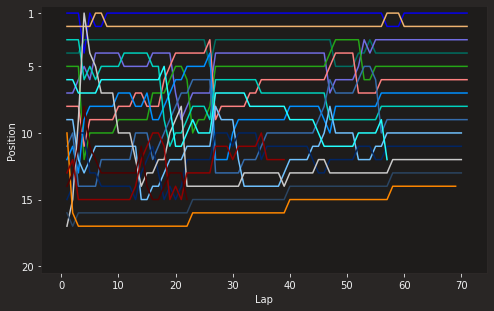

In [13]:
import fastf1.plotting
import matplotlib.pyplot as plt


fastf1.plotting.setup_mpl(misc_mpl_mods=False)


session = fastf1.get_session(2023, "Brazil", 'R')
session.load(telemetry=False, weather=False)

fig, ax = plt.subplots(figsize=(8.0, 4.9))


for drv in session.drivers:
    drv_laps = session.laps.pick_driver(drv)

    abb = drv_laps['Driver'].iloc[0]
    color = fastf1.plotting.driver_color(abb)

    ax.plot(drv_laps['LapNumber'], drv_laps['Position'],
            label=abb, color=color)

ax.set_ylim([20.5, 0.5])
ax.set_yticks([1, 5, 10, 15, 20])
ax.set_xlabel('Lap')
ax.set_ylabel('Position')
Text(0, 0.5, 'Position')

ax.legend(bbox_to_anchor=(1.0, 1.02))
plt.tight_layout()

plt.show()

In [3]:
#Results
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")
year=2023
wknd ="Abu Dhabi"
ses = 'R'
session = fastf1.get_session(year, wknd, ses)
session.load()
results = session.results
print(results)
results.to_csv('ResultsAbuR2023.csv')

core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	No cached data found for position_data. Loading data...
_api           INFO 	Fetching position data...
_api           INFO 	Parsing position data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for weather_data. Loading data...
_api           INFO 	Fetching weather data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for race_control_messages. Loading data.

   DriverNumber BroadcastName Abbreviation         DriverId         TeamName  \
1             1  M VERSTAPPEN          VER   max_verstappen  Red Bull Racing   
16           16     C LECLERC          LEC          leclerc          Ferrari   
63           63     G RUSSELL          RUS          russell         Mercedes   
11           11       S PEREZ          PER            perez  Red Bull Racing   
4             4      L NORRIS          NOR           norris          McLaren   
81           81     O PIASTRI          PIA          piastri          McLaren   
14           14      F ALONSO          ALO           alonso     Aston Martin   
22           22     Y TSUNODA          TSU          tsunoda       AlphaTauri   
44           44    L HAMILTON          HAM         hamilton         Mercedes   
18           18      L STROLL          STR           stroll     Aston Martin   
3             3   D RICCIARDO          RIC        ricciardo       AlphaTauri   
31           31        E OCON          O

In [13]:
#pickSpecificlap
# Enable cache
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")

# Initialize DataFrame
gapQ = pd.DataFrame(columns=['Driver', 'Gap'])

year = 2023
gp = "Abu dhabi"
ses = 'Q'
driver = 'NOR'
laps = session.laps.pick_driver(driver)
lap=laps[laps['LapNumber']==15].iloc[0]
print(lap)
#Telemetry
x = lap.telemetry['X']              
y = lap.telemetry['Y']
speed = lap.telemetry['Speed']
tel=pd.DataFrame({'X': x, 'Y': y,'Speed': speed })
#tel.to_csv("LAWQSIN.csv")

Time                      0 days 01:14:21.589000
Driver                                       NOR
DriverNumber                                   4
LapTime                   0 days 00:01:23.952000
LapNumber                                   15.0
Stint                                        6.0
PitOutTime                                   NaT
PitInTime                                    NaT
Sector1Time               0 days 00:00:17.076000
Sector2Time               0 days 00:00:36.087000
Sector3Time               0 days 00:00:30.789000
Sector1SessionTime        0 days 01:13:14.713000
Sector2SessionTime        0 days 01:13:50.800000
Sector3SessionTime        0 days 01:14:21.589000
SpeedI1                                    291.0
SpeedI2                                    319.0
SpeedFL                                    219.0
SpeedST                                    322.0
IsPersonalBest                             False
Compound                                    SOFT
TyreLife            

In [6]:
#STINTS

fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")
session = fastf1.get_session(2023, "Abu Dhabi", 'R')
session.load()
laps = session.laps
drivers = session.drivers
print(drivers)
drivers = [session.get_driver(driver)["Abbreviation"] for driver in drivers]
print(drivers)
stints = laps[["Driver", "Stint", "Compound", "LapNumber"]]
stints = stints.groupby(["Driver", "Stint", "Compound"])
stints = stints.count().reset_index()
stints = stints.rename(columns={"LapNumber": "StintLength"})
print(stints)

stints.to_csv("StintsAbu.csv")



core           INFO 	Loading data for Abu Dhabi Grand Prix - Race [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '16', '63', '11', '4', '81', '14', '22', '44', '18', '3', '31', '10', '23', '27', '2', '24', '55', '77', '20']


['1', '16', '63', '11', '4', '81', '14', '22', '44', '18', '3', '31', '10', '23', '27', '2', '24', '55', '77', '20']
['VER', 'LEC', 'RUS', 'PER', 'NOR', 'PIA', 'ALO', 'TSU', 'HAM', 'STR', 'RIC', 'OCO', 'GAS', 'ALB', 'HUL', 'SAR', 'ZHO', 'SAI', 'BOT', 'MAG']
   Driver  Stint Compound  StintLength
0     ALB    1.0   MEDIUM           16
1     ALB    2.0     HARD           27
2     ALB    3.0     HARD           15
3     ALO    1.0   MEDIUM           12
4     ALO    2.0     HARD           24
5     ALO    3.0     HARD           22
6     BOT    1.0     HARD           29
7     BOT    2.0   MEDIUM           28
8     GAS    1.0   MEDIUM           17
9     GAS    2.0     HARD           15
10    GAS    3.0     HARD           26
11    HAM    1.0   MEDIUM           15
12    HAM    2.0     HARD           20
13    HAM    3.0     HARD           23
14    HUL    1.0   MEDIUM           13
15    HUL    2.0     HARD           20
16    HUL    3.0     HARD           25
17    LEC    1.0   MEDIUM           17
1

In [10]:
#racepace
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")
year = 2023
wknd = "Mexico"
ses = "R"
session = fastf1.get_session(year, wknd, ses)
session.load()
drivers = ["VER","PIA","NOR","RUS","LEC","SAI","ALB","OCO","HAM","RIC"]
lap_data2 = []
for driver in drivers:
    driver_laps = session.laps.pick_driver(driver).pick_quicklaps().reset_index()
    driver_laps['Driver'] = driver  # Add driver column
    driver_laps['LapTime'] = driver_laps['LapTime'].dt.total_seconds()  # Convert to seconds
    lap_data2.append(driver_laps)

# Concatenate the lap data for all drivers
all_laps2 = pd.concat(lap_data2, ignore_index=True)

# Save the lap data to a CSV file
csv_filename = "racepaceMexico.csv"
all_laps2.to_csv(csv_filename, index=False)
print(f"Lap data saved to {csv_filename}")
print(all_laps2)

core           INFO 	Loading data for Mexico City Grand Prix - Race [v3.0.7]
req            INFO 	Using cached data for driver_info
core        WARNING 	No result data for this session available on Ergast! (This is expected for recent sessions)
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	Cannot load lap times for first lap from Ergast. Timing data is not available for this session.
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['16', '55'

Lap data saved to racepaceMexico.csv
     index                   Time Driver DriverNumber  LapTime  LapNumber  \
0        1 0 days 01:05:08.019000    VER            1   83.859        2.0   
1        2 0 days 01:06:31.592000    VER            1   83.573        3.0   
2        3 0 days 01:07:55.300000    VER            1   83.708        4.0   
3        5 0 days 01:11:03.458000    VER            1   83.339        6.0   
4        6 0 days 01:12:26.911000    VER            1   83.453        7.0   
..     ...                    ...    ...          ...      ...        ...   
636    780 0 days 02:59:55.889000    RIC            3   83.133       67.0   
637    781 0 days 03:01:19.124000    RIC            3   83.235       68.0   
638    782 0 days 03:02:42.298000    RIC            3   83.174       69.0   
639    783 0 days 03:04:05.588000    RIC            3   83.290       70.0   
640    784 0 days 03:05:30.902000    RIC            3   85.314       71.0   

     Stint PitOutTime PitInTime       

In [20]:
import fastf1
import pandas as pd

# Enable caching with a specified folder
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")

year = 2023
wknd = "Qatar"
ses = "Sprint"

# Get the session data
session = fastf1.get_session(year, wknd, ses)
session.load()

# Extract lap data
laps = session.laps
lapsbycompound = laps[["LapNumber", "LapTime", "Compound"]]

# Convert lap time to seconds
lapsbycompound["LapTime"] = lapsbycompound['LapTime'].dt.total_seconds()

# Remove rows with NaN values in the "LapTime" column
lapsbycompound = lapsbycompound.dropna(subset=["LapTime"])

# Calculate the average lap time for each lap, grouped by compound
lapst = lapsbycompound.groupby(["LapNumber", "Compound"])["LapTime"].mean().reset_index()
lapst.rename(columns={"LapTime": "AvgLT"}, inplace=True)

# Print or save the result
print(lapst)

# Save the result to a CSV file
#lapst.to_csv('SprintQatar.csv', index=False)


core           INFO 	Loading data for Qatar Grand Prix - Sprint [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['81', '1', '4', '63', '44', '55', '23', '14', '10', '77', '22', '16', '18', '20', '24', '27', '31', '11', '2', '40']


    LapNumber Compound       AvgLT
0         2.0   MEDIUM  133.439000
1         2.0     SOFT  137.768375
2         3.0   MEDIUM  106.716455
3         3.0     SOFT  101.457429
4         4.0   MEDIUM  138.284182
5         4.0     SOFT  138.759857
6         5.0   MEDIUM  142.547000
7         5.0     SOFT  141.910000
8         6.0   MEDIUM  134.960000
9         6.0     SOFT  139.601000
10        7.0   MEDIUM   90.692636
11        7.0     SOFT   89.647571
12        8.0   MEDIUM   89.762091
13        8.0     SOFT   89.141000
14        9.0   MEDIUM   89.341545
15        9.0     SOFT   89.709429
16       10.0   MEDIUM   89.359182
17       10.0     SOFT   89.957714
18       11.0   MEDIUM  103.871889
19       11.0     SOFT  104.155000
20       12.0   MEDIUM  144.477286
21       12.0     SOFT  145.523000
22       13.0     SOFT  149.474667
23       14.0   MEDIUM  136.787000
24       14.0     SOFT  135.152375
25       15.0   MEDIUM   90.047000
26       15.0     SOFT   90.418125
27       16.0   MEDI

/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_18492/2549542885.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  lapsbycompound["LapTime"] = lapsbycompound['LapTime'].dt.total_seconds()


In [25]:
import fastf1
import fastf1.plotting
import seaborn as sns
from matplotlib import pyplot as plt
race = fastf1.get_session(2023, "Qatar", 'R')
race.load()
laps = race.laps
pos=laps[["Driver","LapNumber","Position"]]
pos.to_csv('PosQatar.csv', index=False)

core           INFO 	Loading data for Qatar Grand Prix - Race [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 55
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate.
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '81', '4', '63', '16', '14', '31', '77', '24', '11', '18', '10', '23', '20', '22', '27', '40', '2', '44

In [ ]:


year = 2021
ses = 'Q'
position = pd.DataFrame(columns=['Driver', 'Position','Q','Qualy'])

for i in range(1,13):
    session = fastf1.get_session(year, i, ses)
    session.load()
    drivers=pd.unique(session.results['Abbreviation'])
    for driver in drivers:
        results=session.get_driver(driver)
        qualy=results['Position']
        if qualy<=10: 
            q="Q3"
        elif qualy>10 and qualy<=15: 
            q="Q2"
        else:
            q="Q1"
        pos = {'Driver': driver, 'Position': qualy,'Q':q,'Qualy': 1}
        position = position.append(pos, ignore_index=True)


print(position)
position.to_csv("MIDSEASONQUALYtype.csv")

In [48]:
#Sprint points and positions
year = 2023
ses = 'Sprint'
position = pd.DataFrame(columns=['Driver', 'Position','GP','Points',"Sprint"])
gps=["Azerbaijan","Austria","Belgium","Qatar","Austin","Brazil"]
for gp in gps: 
    session = fastf1.get_session(year, gp, ses)
    session.load()
    drivers = pd.unique(session.laps['Driver'])
    for driver in drivers:
        results=session.get_driver(driver)
        pos=results['Position']
        points=results['Points']
        pod = {'Driver': driver, 'Position': pos,'GP':gp,'Points': points,"Sprint":1}
        position = position.append(pod, ignore_index=True)

print(position)
#position.to_csv("MIDSEASONQUALYtype.csv")

core           INFO 	Loading data for Azerbaijan Grand Prix - Sprint [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 2
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate.
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '16', '1', '63', '55', '14', '44', '18', '23', '81', '20', '24', '10', '21', '27', '77', '4', '3

/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pod, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pod, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pod, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use 

core           INFO 	Loading data for Qatar Grand Prix - Sprint [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['81', '1', '4', '63', '44', '55', '23', '14', '10', '77', '22', '16', '18', '20', '24', '27', '31', '11', '2', '40']
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is de

core           INFO 	Loading data for São Paulo Grand Prix - Sprint [v3.0.7]
req            INFO 	Using cached data for driver_info
core        WARNING 	No result data for this session available on Ergast! (This is expected for recent sessions)
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['4', '1', '11', '63', '44', '22', '16', '3', '55', '81', '20', '27', '10', '77', '14', '31', '18', '24', '23', '2']
/var/folder

    Driver Position          GP Points Sprint
0      PER      1.0  Azerbaijan    8.0      1
1      LEC      2.0  Azerbaijan    7.0      1
2      VER      3.0  Azerbaijan    6.0      1
3      RUS      4.0  Azerbaijan    5.0      1
4      SAI      5.0  Azerbaijan    4.0      1
..     ...      ...         ...    ...    ...
114    OCO      NaN      Brazil    NaN      1
115    STR      NaN      Brazil    NaN      1
116    ZHO      NaN      Brazil    NaN      1
117    ALB      NaN      Brazil    NaN      1
118    SAR      NaN      Brazil    NaN      1

[119 rows x 5 columns]


/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pod, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pod, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pod, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/2174245065.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use 

In [49]:
position.to_csv("Sprint.csv")

In [51]:
position_complete=pd.read_csv("Sprint.csv")
grouped=position_complete.groupby("Driver")
pointsSprint = grouped['Points'].sum()
print(pointsSprint)
pointsSprint.to_csv("pointsSprint.csv")

Driver
ALB     2
ALO     8
BOT     0
DEV     0
GAS     8
HAM    17
HUL     3
LAW     0
LEC    21
MAG     0
NOR    21
OCO     2
PER    25
PIA    15
RIC     0
RUS    18
SAI    22
SAR     0
STR     6
TSU     3
VER    45
ZHO     0
Name: Points, dtype: int64


In [65]:
position_complete4=pd.read_csv("Sprint.csv")
grouped=position_complete4.groupby("Driver")
pointsSprint = grouped['Points'].mean()
print(pointsSprint)
pointsSprint.to_csv("avgpointsSprint.csv")

Driver
ALB    0.333333
ALO    1.333333
BOT    0.000000
DEV    0.000000
GAS    1.333333
HAM    2.833333
HUL    0.500000
LAW    0.000000
LEC    3.500000
MAG    0.000000
NOR    3.500000
OCO    0.333333
PER    4.166667
PIA    2.500000
RIC    0.000000
RUS    3.000000
SAI    3.666667
SAR    0.000000
STR    1.000000
TSU    0.500000
VER    7.500000
ZHO    0.000000
Name: Points, dtype: float64


In [53]:
#Sprint positions
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")

year = 2023
ses = 'Sprint'
position = pd.DataFrame(columns=['Driver', 'Position', 'Status', 'Finish', 'Race'])
gps=["Azerbaijan","Austria","Belgium","Qatar","Austin","Brazil"]
for gp in gps:
    session = fastf1.get_session(year, gp, ses)
    session.load()
    drivers = pd.unique(session.results['Abbreviation'])
    for driver in drivers:
        results = session.get_driver(driver)
        qualy = results['Position']
        status = results['Status']
        if status in ['Finished', '+1 Lap', '+2 Laps']:
            if qualy == 1:
                finish = "Win"
            elif (qualy == 3) or (qualy==2):
                finish = "Podium"
            elif qualy <= 8:
                finish = "Points"
            else:
                finish = "Out of the points"
        else:
            finish = "DNF"
        pos = {'Driver': driver, 'Position': qualy, 'Status': status, 'Finish': finish, 'Race': 1}
        position = position.append(pos, ignore_index=True)
    print(gp)

print(position)
position.to_csv("SprintPos.csv")

core           INFO 	Loading data for Azerbaijan Grand Prix - Sprint [v3.0.7]
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for lap_count
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
core        WARNING 	No lap data for driver 2
core        WARNING 	Failed to perform lap accuracy check - all laps marked as inaccurate.
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['11', '16', '1', '63', '55', '14', '44', '18', '23', '81', '20', '24', '10', '21', '27', '77', '4', '3

Azerbaijan


req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '11', '55', '18', '14', '27', '31', '63', '4', '44', '81', '16', '23', '20', '10', '22', '21', '2', '24', '77']
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipyker

Austria


req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '81', '10', '55', '16', '4', '44', '63', '31', '3', '18', '23', '77', '20', '24', '2', '27', '22', '11', '14']
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykern

Belgium


req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['81', '1', '4', '63', '44', '55', '23', '14', '10', '77', '22', '16', '18', '20', '24', '27', '31', '11', '2', '40']
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipyker

Qatar


req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '44', '16', '4', '11', '55', '10', '63', '23', '81', '31', '3', '14', '22', '27', '77', '24', '20', '2', '18']
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykern

Austin


req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['4', '1', '11', '63', '44', '22', '16', '3', '55', '81', '20', '27', '10', '77', '14', '31', '18', '24', '23', '2']
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykern

Brazil
    Driver Position    Status  Finish Race
0      PER      1.0  Finished     Win    1
1      LEC      2.0  Finished  Podium    1
2      VER      3.0  Finished  Podium    1
3      RUS      4.0  Finished  Points    1
4      SAI      5.0  Finished  Points    1
..     ...      ...       ...     ...  ...
115    OCO      NaN               DNF    1
116    STR      NaN               DNF    1
117    ZHO      NaN               DNF    1
118    ALB      NaN               DNF    1
119    SAR      NaN               DNF    1

[120 rows x 5 columns]


/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/3456237104.py:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use 

In [64]:
position_complete3=pd.read_csv("SprintPos.csv")
grouped=position_complete3.groupby("Driver")
pointsSprint = grouped['Position'].mean()
print(pointsSprint)
pointsSprint.to_csv("RaceSprint.csv")

Driver
ALB    10.833333
ALO    10.500000
BOT    15.666667
DEV    15.500000
GAS    10.000000
HAM     6.333333
HUL    14.500000
LAW    20.000000
LEC     6.500000
MAG    14.500000
NOR     6.833333
OCO    12.666667
PER     8.000000
PIA     7.333333
RIC    10.333333
RUS     6.000000
SAI     5.333333
SAR    18.666667
STR    11.333333
TSU    14.000000
VER     1.500000
ZHO    15.833333
Name: Position, dtype: float64


In [60]:
#Sprint Qualy
fastf1.Cache.enable_cache("/Users/ainefernandez/documents/itam/8SEMESTRE/F1 Python")

year = 2023
ses = 'Sprint Shootout'
position = pd.DataFrame(columns=['Driver', 'Position','Q','Qualy'])
gps=["Azerbaijan","Austria","Belgium","Qatar","Austin","Brazil"]
for gp in gps:
    session = fastf1.get_session(year, gp, ses)
    session.load()
    drivers=pd.unique(session.results['Abbreviation'])
    for driver in drivers:
        results=session.get_driver(driver)
        qualy=results['Position']
        if qualy<=10: 
            q="SQ3"
        elif qualy>10 and qualy<=15: 
            q="SQ2"
        else:
            q="SQ1"
        pos = {'Driver': driver, 'Position': qualy,'Q':q,'Qualy': 1}
        position = position.append(pos, ignore_index=True)


print(position)
position.to_csv("SprintsQUALYtype.csv")

core           INFO 	Loading data for Azerbaijan Grand Prix - Sprint Shootout [v3.0.7]
req            INFO 	Updating cache for driver_info...
_api           INFO 	Fetching driver list...
req            INFO 	Cache updated!
core        WARNING 	No result data for this session available on Ergast! (This is expected for recent sessions)
req            INFO 	Updating cache for session_status_data...
_api           INFO 	Fetching session status data...
req            INFO 	Cache updated!
req            INFO 	Updating cache for track_status_data...
_api           INFO 	Fetching track status data...
req            INFO 	Cache updated!
req            INFO 	Updating cache for timing_data...
_api           INFO 	Fetching timing data...
_api           INFO 	Parsing timing data...
req            INFO 	Cache updated!
req            INFO 	Updating cache for timing_app_data...
_api           INFO 	Fetching timing app data...
req            INFO 	Cache updated!
core           INFO 	Processing timing d

_api           INFO 	Fetching timing app data...
req            INFO 	Data has been written to cache!
core           INFO 	Processing timing data...
req            INFO 	No cached data found for car_data. Loading data...
_api           INFO 	Fetching car data...
_api           INFO 	Parsing car data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for position_data. Loading data...
_api           INFO 	Fetching position data...
_api           INFO 	Parsing position data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for weather_data. Loading data...
_api           INFO 	Fetching weather data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for race_control_messages. Loading data...
_api           INFO 	Fetching race control messages...
req            INFO 	Data has been written to cache!
core           INFO 	Finished loading data for 20 dr

/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/135188056.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/135188056.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/135188056.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/135188056.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pand

core           INFO 	Loading data for United States Grand Prix - Sprint Shootout [v3.0.7]
req            INFO 	No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
req            INFO 	Data has been written to cache!
core        WARNING 	No result data for this session available on Ergast! (This is expected for recent sessions)
req            INFO 	No cached data found for session_status_data. Loading data...
_api           INFO 	Fetching session status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for timing_data. Loading data...
_api           INFO 	Fetching timing data...
_api           INFO 	Parsing timing data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached da

req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for track_status_data. Loading data...
_api           INFO 	Fetching track status data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for timing_data. Loading data...
_api           INFO 	Fetching timing data...
_api           INFO 	Parsing timing data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for timing_app_data. Loading data...
_api           INFO 	Fetching timing app data...
req            INFO 	Data has been written to cache!
core           INFO 	Processing timing data...
req            INFO 	No cached data found for car_data. Loading data...
_api           INFO 	Fetching car data...
_api           INFO 	Parsing car data...
req            INFO 	Data has been written to cache!
req            INFO 	No cached data found for position_data. Loading data...
_api           INFO 	Fetching po

    Driver Position    Q Qualy
0      LEC      1.0  SQ3     1
1      PER      2.0  SQ3     1
2      VER      3.0  SQ3     1
3      RUS      4.0  SQ3     1
4      SAI      5.0  SQ3     1
..     ...      ...  ...   ...
114    OCO     16.0  SQ1     1
115    STR     17.0  SQ1     1
116    ZHO     18.0  SQ1     1
117    ALB     19.0  SQ1     1
118    SAR     20.0  SQ1     1

[119 rows x 4 columns]


/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/135188056.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/135188056.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/135188056.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  position = position.append(pos, ignore_index=True)
/var/folders/z3/f6b2q8h90wsgpsmjqkk2lnt80000gn/T/ipykernel_73411/135188056.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pand

In [62]:
position_complete2=pd.read_csv("SprintsQUALYtype.csv")
grouped=position_complete2.groupby("Driver")
pointsSprint = grouped['Position'].mean()
print(pointsSprint)
pointsSprint.to_csv("QualySprint.csv")

Driver
ALB    12.333333
ALO    11.166667
BOT    16.333333
DEV    17.000000
GAS    11.833333
HAM     8.500000
HUL    11.000000
LAW    14.000000
LEC     4.333333
MAG    14.000000
NOR     4.166667
OCO    11.666667
PER     5.000000
PIA     7.666667
RIC    11.000000
RUS     7.500000
SAI     5.500000
SAR    19.000000
STR    14.000000
TSU    14.333333
VER     1.833333
ZHO    16.333333
Name: Position, dtype: float64


In [ ]:
def calculate_points(position, fastest_lap=False):
    if 1 <= position <= 10:
        points = [25, 18, 15, 12, 10, 8, 6, 4, 2, 1]
        total_points = points[position - 1]

        if fastest_lap:
            total_points += 1

        return total_points
    else:
        return 0

def check_4th_place(driver_points, driver_name):
    fourth_place_points = sorted(driver_points)[-4]
    fourth_place_index = driver_points.index(fourth_place_points)

    print(f"{driver_name} needs to finish {fourth_place_index + 1}th to secure 4th place.")
    print("Scenarios:")
    for i, points in enumerate(driver_points):
        if points == fourth_place_points:
            print(f"{driver_name} finishes {i + 1}th with {points} points")

# Assuming each driver can finish between 1st and 20th
positions = list(range(1, 21))

# Iterate through all possible finishing positions for each driver
for A in positions:
    for S in positions:
        for N in positions:
            for L in positions:
                # Check for repeated positions
                if len(set([A, S, N, L])) == 4:
                    # Calculate points for each driver
                    Alonso_points = calculate_points(A)
                    Sainz_points = calculate_points(S)
                    Norris_points = calculate_points(N)
                    Leclerc_points = calculate_points(L)

                    # Check for fastest lap scenarios (add 1 point to one driver)
                    for driver in [Alonso_points, Sainz_points, Norris_points, Leclerc_points]:
                        fastest_lap_points = calculate_points(position=1, fastest_lap=True)
                        driver += fastest_lap_points

                    # Check if each driver finishes 4th in the championship
                    if sorted([Alonso_points, Sainz_points, Norris_points, Leclerc_points])[-4] == Alonso_points:
                        print("\n=== Scenario ===")
                        print(f"Fernando Alonso: {Alonso_points} points (Position {A})")
                        print(f"Carlos Sainz: {Sainz_points} points (Position {S})")
                        print(f"Lando Norris: {Norris_points} points (Position {N})")
                        print(f"Charles Leclerc: {Leclerc_points} points (Position {L})")

                        # Additional information for each driver if they finish 4th
                        check_4th_place([Alonso_points, Sainz_points, Norris_points, Leclerc_points], "Alonso")
                        check_4th_place([Sainz_points, Alonso_points, Norris_points, Leclerc_points], "Sainz")
                        check_4th_place([Norris_points, Alonso_points, Sainz_points, Leclerc_points], "Norris")
                        check_4th_place([Leclerc_points, Alonso_points, Sainz_points, Norris_points], "Leclerc")



=== Scenario ===
Fernando Alonso: 12 points (Position 4)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 12 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 12 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 12 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 12 points

=== Scenario ===
Fernando Alonso: 12 points (Position 4)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 12 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 12 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 12 points


Norris finishes 2th with 6 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 6 points

=== Scenario ===
Fernando Alonso: 6 points (Position 7)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 6 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 6 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 6 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 6 points

=== Scenario ===
Fernando Alonso: 6 points (Position 7)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 6 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz f

=== Scenario ===
Fernando Alonso: 4 points (Position 8)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 4 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 4 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 4 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 4 points

=== Scenario ===
Fernando Alonso: 4 points (Position 8)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 4 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 4 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 4 points
Leclerc ne

Sainz finishes 2th with 4 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 4 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 4 points

=== Scenario ===
Fernando Alonso: 4 points (Position 8)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 4 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 4 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 4 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 4 points

=== Scenario ===
Fernando Alonso: 4 points (Position 8)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso 

Lando Norris: 8 points (Position 6)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 4 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 4 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 4 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 4 points

=== Scenario ===
Fernando Alonso: 2 points (Position 9)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 2 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 2 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 2 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 2 points

=== Scen

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 2 points

=== Scenario ===
Fernando Alonso: 2 points (Position 9)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 2 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 2 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 2 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 2 points

=== Scenario ===
Fernando Alonso: 2 points (Position 9)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 2 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 2 points
Norris nee

Alonso finishes 1th with 2 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 2 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 2 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 2 points

=== Scenario ===
Fernando Alonso: 2 points (Position 9)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 2 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 2 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 2 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 2 points

=== Scenario ===
Fernando Alonso: 2 points (Position 9)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 10 points (Position 5)
Charles Leclerc

Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2t

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sai

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 10 points (Po

Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:

Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 1 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 1 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 1 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 1 points

=== Scenario ===
Fernando Alonso: 1 points (Position 10)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios

Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenario

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th 

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th

Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Lecl

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th 


=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 8 p

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 12 poin

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 

Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scena

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2t

Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishe

Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (P

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs t

Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Pos

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points 

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc fini

Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios

Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fe

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:

Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 12 points (Posi

Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc fin

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finis

Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to 

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 

Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 18 points (Po

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos

Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 point


=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 20)
Alonso needs

Lando Norris: 4 points (Position 8)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1t

Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th wit


=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 18)
Alonso needs

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc fin

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th

Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
L

Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz n

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 

Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
S

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fin

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish

Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finish

Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th w

Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 

Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th w

Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 poi

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishe

Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fe

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0

Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 15)
Alonso n

Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 poi

Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 

Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0

Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th wi

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 11)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fe

Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th 

Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
L

Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with

Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris 

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris ne

Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to 

Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 12 points (Positi

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz n

Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 poi

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 25

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz 

Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 poi

Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 25 points (Position 1)
Charles Lecl

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 

Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th wit

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0

Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th p

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 


=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc need

Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th pla

Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 18 points (Position 2)
Ch

Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alons

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Posi

Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc f

Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alo

Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th wit

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 1 points

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 4 poin

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fe

Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finis

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 

Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3t

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc fini

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris fini

Lando Norris: 4 points (Position 8)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 

Lando Norris: 0 points (Position 15)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishe

Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 19)
Charles Lec

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 point

Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sain

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 2 points (Position 9)
Alonso needs to fini

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 point

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 

Lando Norris: 0 points (Position 13)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes

Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
S

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with

Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alons

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Le

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 point

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1t

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs 

Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th 

Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4

Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 p

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 12 points (Position 4)
Alonso needs 

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1t

Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 4 points (Posi

Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 0 points (Position 19)
Alonso n

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 12)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th 

Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso f

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 6 points (Position 7)
Alonso needs to fini

Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to 

Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishe

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 25 points (Position 1)
Alonso needs 

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz f

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 point

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to s

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
N

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris fin


=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 25 points (Position 1)
Alonso needs

Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 12 p

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 p

Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with

Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finis

Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 12)
Alonso nee

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fin

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th wi

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 12 p

Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th p

Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 point

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso f

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fin

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sai

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish

Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to se

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.


Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 25 

Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Le

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc fin

Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs 

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 4 poin

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Nor


=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 0 points (Position 11)
Alonso needs

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 

Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alo

Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc f

Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secur

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finis

Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to fi

Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4t

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario

Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishe

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 2 points

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 point

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finis

Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0

Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 8 points (Posi

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc fin

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 18 

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finis

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points

Fernando Alonso: 0 points (Position 13)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 13)
Carlos S

Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 18 points (Position 2)
Alonso needs to fi

Lando Norris: 0 points (Position 11)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th 

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlo

Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos

Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to 

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 15 points (Po

Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc fin

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 10

Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Pos

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso f

Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris fin

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris fin

Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Le

Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th p

Lando Norris: 0 points (Position 12)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs t


=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc nee

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sain

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 6 points

Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th p

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0

Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 

Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 

Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to se

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 

Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 

Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishe

Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secu

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
No

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0

Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0

Carlos Sainz: 0 points (Position 12)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 

Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishe

Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 20)
Alonso needs 

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 2 points

Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finis

Lando Norris: 25 points (Position 1)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 

Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secur

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points

Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th 

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fin

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris fin

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finis

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fin

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc fin

Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th wit

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 


=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fe

Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th w

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 8 p

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 2

Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0

Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fini

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishe

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 14)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
S

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 15

Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris fi

Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Po

Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2t

Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to 

Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Le

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso f

Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th 

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secu


=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 18)
Alonso needs

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with

Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Sc

Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc fi

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th 


=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th w

Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secu

Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2

Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
F

Carlos Sainz: 10 points (Position 5)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc

Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th 

Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0

Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place

Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:

Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to s

Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos

Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th w

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 12 points

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 

Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 point

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 10 p

Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to se

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th w

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secu

Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 12)
Alonso nee

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz fi

Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 

Carlos Sainz: 1 points (Position 10)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc

Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso f

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 2 points

Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th 

Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc fini

Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 


=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 18 points (Position 2)
Alonso needs

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs 

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 15 po

Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fi

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 6

Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to 

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 4 points (Pos

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Nor

Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with

Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc fini

Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishe

Lando Norris: 0 points (Position 18)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 10 points (Position 5)
Alonso needs to fi

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 14)
Alonso needs to

Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th 

Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs t

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs 

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 8 point

Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4t

Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finis

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fe

Carlos Sainz: 0 points (Position 18)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with

Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alon

Carlos Sainz: 0 points (Position 18)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finish

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Nor

Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 

Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3

Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishe

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish

Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
F

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 1 

Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 15)
Carlos Sainz: 0 point

Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 10 points (Position 5)
Charles Lecl

Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 2 points

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris

Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris fi

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Po

Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
L

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th w


=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th w

Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th wi

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlo

Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th 

Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secur

Lando Norris: 18 points (Position 2)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Sce

Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 

Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th p

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz f

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 20)
Alonso needs to


=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc n

Carlos Sainz: 6 points (Position 7)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc fin

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th 

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th wi

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th pla

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes

Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th t

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secur

Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th wi

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 2 points

Carlos Sainz: 1 points (Position 10)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fin

Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th 

Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishe

Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th w

Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alon

Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 poi

Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishe

Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 

Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishe

Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 

Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 

Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 

Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos S

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th 

Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
N

Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norr

Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3

Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 18 poi

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishe

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 17)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th

Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alon

Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secur

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs 

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlo

Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 

Carlos Sainz: 0 points (Position 20)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fini

Carlos Sainz: 0 points (Position 20)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finish

Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishe

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 16)
Carlos Sainz: 0 point

Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Sc

Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso f

Carlos Sainz: 18 points (Position 2)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc f

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 0 points (Position 11)
Alonso needs to fi

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes

Carlos Sainz: 15 points (Position 3)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sai

Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:


=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc ne

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 p

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 

Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th wit

Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alo


=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 13)
Alonso needs

Lando Norris: 12 points (Position 4)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scena

Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 

Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Nor

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 point

Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th

Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fin

Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 6 points (Positi

Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 

Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 po

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 0 

Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th t

Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alon

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 

Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 poi

Carlos Sainz: 0 points (Position 11)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fini

Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 18)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0

Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 

Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 0 points (Position 16)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishe

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 point

Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso fini

Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1t

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.


Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th w

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris fin

Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 p

Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th w

Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 25 

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 6 points (Position 7)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 point

Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to 

Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 0 points (Position 18)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to

Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc f

Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 8 points (Position 6)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th pla

Lando Norris: 0 points (Position 13)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 16)
Lando Norris: 0 points (Position 19)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
F


=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 

Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 18)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc fini

Lando Norris: 25 points (Position 1)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0

Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sain

Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 19)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
S

Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sai

Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 

Lando Norris: 0 points (Position 15)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 17)
Carlos Sainz: 0 points (Position 20)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishe

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris fin

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 2 points (Position 9)
Cha

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
No

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 25 points (Position 1)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishe

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th w

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 18 points (Position 2)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishe

Carlos Sainz: 15 points (Position 3)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Lecle

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 2 points (Position 9)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th pl

Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secur

Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 15 points (Position 3)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to s

Carlos Sainz: 12 points (Position 4)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 25 points (Position 1)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th wi

Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 12 points (Position 4)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 

Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 12 points (Position 4)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (

Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 poi

Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 10 points (Position 5)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to 

Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to s

Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Posit


=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 15 points (Position 3)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 8 points (Position 6)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 12 points (Position 4)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2

Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th p

Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:

Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 6 points (Position 7)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secur

Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4

Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 1 points (Posit

Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 4 points (Position 8)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th wi


=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2

Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 1 points (Position 10)
Charles Leclerc: 4 points (Position 8)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso f

Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 2 points (Position 9)
Lando Norris: 0 points (Position 15)
Charles Leclerc: 0 points (Position 17)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th 

Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 18 points (Po

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 4th with 

Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 1 points (Position 10)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 0 points (Position 19)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 2th to secure 4th place.
Scenarios:
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 25 points (Position 1)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 point

Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 12)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to se

Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 12)
Charles Leclerc: 0 points (Position 14)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 11)
Lando Norris: 0 points (Position 17)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finis

Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 15 points (Position 3)
Charles Leclerc: 0 points (Position 13)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 

Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 14)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1t

Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 12)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 1 points (Position 10)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1

Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 8 points (Position 6)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos

Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 11)
Charles Leclerc: 10 points (Position 5)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishe

Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 13)
Lando Norris: 0 points (Position 16)
Charles Leclerc: 0 points (Position 15)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finis

Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 18 points (Position 2)
Charles Leclerc: 0 points (Position 20)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 

Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 2 points (Position 9)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 4 points (Position 8)
Charles Leclerc: 1 points (

Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 13)
Charles Leclerc: 6 points (Position 7)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sain

Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points
Leclerc finishes 4th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 14)
Lando Norris: 0 points (Position 20)
Charles Leclerc: 18 points (Position 2)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 3th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 3th with 0 points
Norris needs to finish 1th to secure 4th place.
Scenarios:
Norris finishes 1th with 0 points
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc fin

Leclerc needs to finish 2th to secure 4th place.
Scenarios:
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 18)
Carlos Sainz: 0 points (Position 15)
Lando Norris: 10 points (Position 5)
Charles Leclerc: 0 points (Position 11)
Alonso needs to finish 1th to secure 4th place.
Scenarios:
Alonso finishes 1th with 0 points
Alonso finishes 2th with 0 points
Alonso finishes 4th with 0 points
Sainz needs to finish 1th to secure 4th place.
Scenarios:
Sainz finishes 1th with 0 points
Sainz finishes 2th with 0 points
Sainz finishes 4th with 0 points
Norris needs to finish 2th to secure 4th place.
Scenarios:
Norris finishes 2th with 0 points
Norris finishes 3th with 0 points
Norris finishes 4th with 0 points
Leclerc needs to finish 1th to secure 4th place.
Scenarios:
Leclerc finishes 1th with 0 points
Leclerc finishes 2th with 0 points
Leclerc finishes 3th with 0 points

=== Scenario ===
Fernando Alonso: 0 points (Position 